In [1]:
# !pip install pydot
# !pip install graphviz
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import glob
from tensorflow import keras
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Conv2D, Activation, Input, UpSampling2D
from tensorflow.keras import optimizers
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import plot_model
from tensorflow.keras import losses

# SRCNN (2014)

In [2]:
#################
# Load Image
################
'''
사용한 이미지는 고해상도 및 저해상도 각 100장씩으로 쌍을 이루고 있으며, 캐글 Super Resolution 데이터 셋을 사용.
저해상도 이미지는 입력 데이터로 사용되며, 모델을 거쳐 나온 이미지는 고해상도 이미지와 loss를 계산해 학습하는 방식을 거침.

#SRCNN 모델 순서
저해상도 이미지를 bicubic interpolation을 통해 (96,96) 사이즈를 고해상도 이미지 사이즈로(384,384) 통일 후, 3개의 Conv layer를 거침.

#SRCNN 테스트 결과
육안으로 확인했을 때 이미지의 해상도가 좋아지지 않았음.
논문과의 차이점은 고해상도 이미지 사이즈 (32,32) 대비 사용된 이미지 사이즈가(384, 384) 컸던 것이 성능에 영향을 미쳤을 것으로 생각 
Conv layer를 추가하거나 옵션을 변경해서 테스트할 필요가 있어 보였음.
'''
HR_dir = './Data/HR/' # 고해상도 디렉토리 
LR_dir = './Data/LR' # 저해상도 디렉토리

def load_img(directory):
    img = []
    for img_dir in glob.glob(directory+str('/*')):
        tmp = plt.imread(img_dir)
        tmp = cv2.resize(tmp,dsize=(384,384), interpolation=cv2.INTER_CUBIC)
        img.append(tmp)
    img = np.array(img)
    return img
HR_img = load_img(HR_dir)
LR_img = load_img(LR_dir)

print(f'HR Shape : {HR_img.shape}')
print(f'LR Shape : {LR_img.shape}')
#예시는 아래 참조

HR Shape : (100, 384, 384, 3)
LR Shape : (100, 384, 384, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


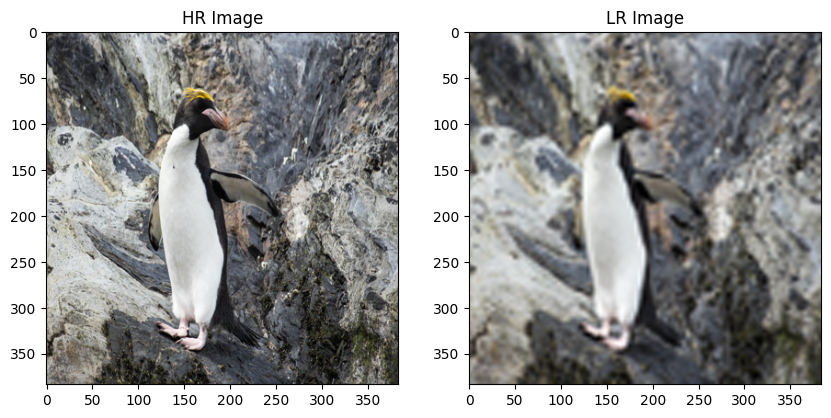

In [59]:
'''
예시 사진
'''
plt.figure(figsize=(10,10))
plt.subplot(1,2,1)
plt.imshow(HR_img[0])
plt.title("HR Image")
plt.subplot(1,2,2)
plt.imshow(LR_img[0])
plt.title('LR Image')
plt.show()

In [146]:
#################
# Train / Test
################
HR_train, HR_val, LR_train, LR_val = train_test_split(HR_img, LR_img, test_size=0.1)

#################
# Build Model
################
def SRCNN(input_shape=(384, 384, 3)): #(384, 384, 3)
    inputs = Input(input_shape, name='input')
    layer = Conv2D(64, 9, padding='same', activation='relu', name='conv1')(inputs)
    layer = Conv2D(32, 1, padding='same', activation='relu', name='conv2')(layer)
    output = Conv2D(3, 5, padding='same', activation='relu', name='conv3')(layer)
    return Model(inputs, output, name='SRCNN')
model = SRCNN()
# def pixel_mse_loss(x,y):
#     return tf.reduce_mean( (x - y) ** 2 )
def PSNR(y_true,y_pred):
    mse=tf.reduce_mean( (y_true - y_pred) ** 2 )
    return 20 * log10(1/ (mse ** 0.5))
model.compile(optimizer=optimizers.Adam(lr=0.001), loss=pixel_mse_loss) # 'mean_squared_error'
model.summary()

Model: "SRCNN"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(None, 384, 384, 3)]     0         
_________________________________________________________________
conv1 (Conv2D)               (None, 384, 384, 64)      15616     
_________________________________________________________________
conv2 (Conv2D)               (None, 384, 384, 32)      2080      
_________________________________________________________________
conv3 (Conv2D)               (None, 384, 384, 3)       2403      
Total params: 20,099
Trainable params: 20,099
Non-trainable params: 0
_________________________________________________________________


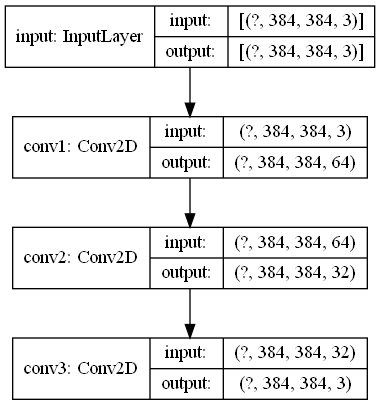

In [86]:
plot_model(model, to_file = 'SRCNN.png', show_shapes=True)

In [147]:
hist = model.fit(LR_train, HR_train, epochs = 100, validation_data=(LR_val,HR_val))

Epoch 1/100
3/3 [==============================] - 3s 984ms/step - loss: 0.1382 - val_loss: 0.1189
Epoch 2/100
3/3 [==============================] - 4s 1s/step - loss: 0.0759 - val_loss: 0.0189
Epoch 3/100
3/3 [==============================] - 3s 914ms/step - loss: 0.0270 - val_loss: 0.0261
Epoch 4/100
3/3 [==============================] - 2s 809ms/step - loss: 0.0221 - val_loss: 0.0195
Epoch 5/100
3/3 [==============================] - 3s 1s/step - loss: 0.0182 - val_loss: 0.0198
Epoch 6/100
3/3 [==============================] - 3s 1s/step - loss: 0.0189 - val_loss: 0.0177
Epoch 7/100
3/3 [==============================] - 2s 824ms/step - loss: 0.0162 - val_loss: 0.0161
Epoch 8/100
3/3 [==============================] - 3s 1s/step - loss: 0.0155 - val_loss: 0.0158
Epoch 9/100
3/3 [==============================] - 3s 1s/step - loss: 0.0147 - val_loss: 0.0143
Epoch 10/100
3/3 [==============================] - 2s 830ms/step - loss: 0.0127 - val_loss: 0.0128
Epoch 11/100
3/3 [======

In [148]:
prediction = model.predict(LR_val)

In [140]:
def plot_images(low,pred,high):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Low Image ', color = 'black', fontsize = 20)
    plt.imshow(low)
    plt.subplot(1,3,2)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(pred)
    plt.subplot(1,3,3)
    plt.title('High Image', color = 'green', fontsize = 20)
    plt.imshow(high)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


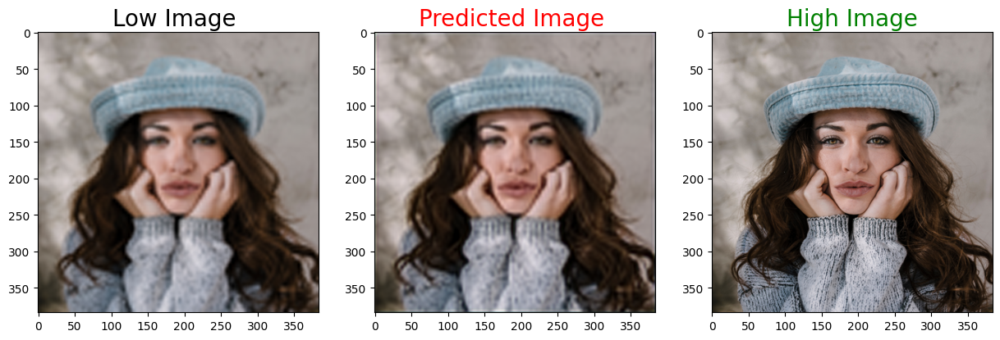

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


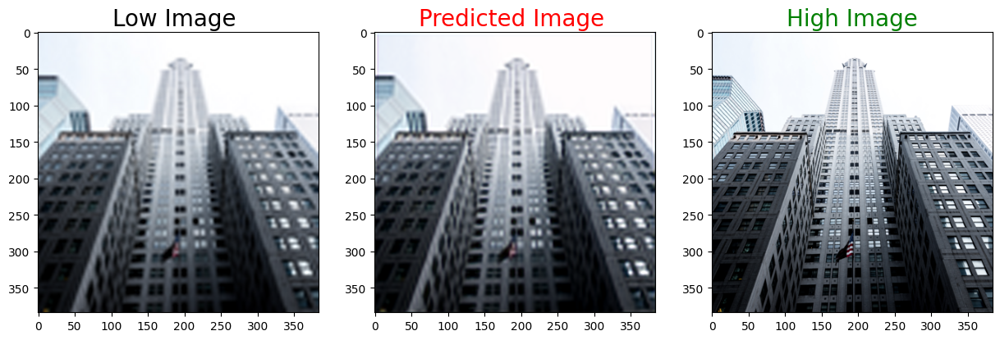

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


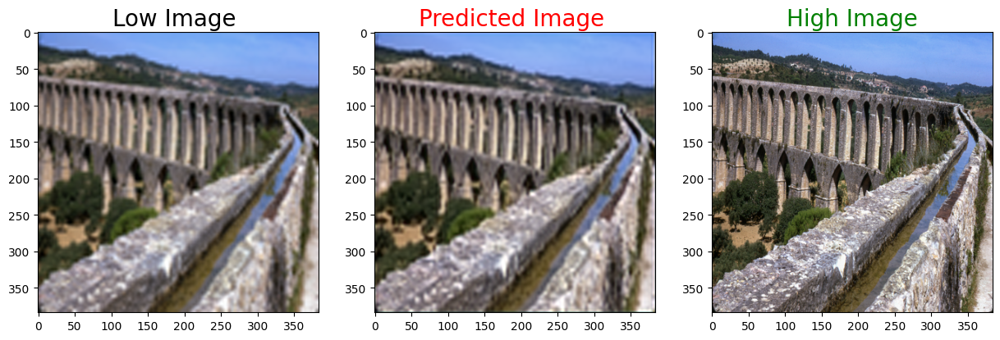

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


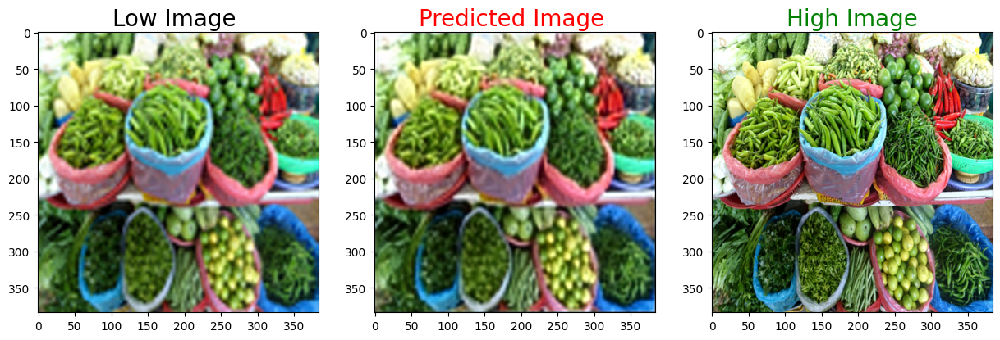

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


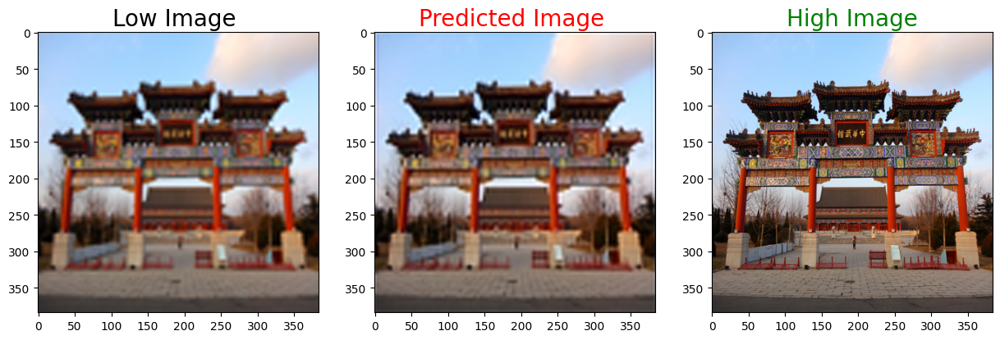

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


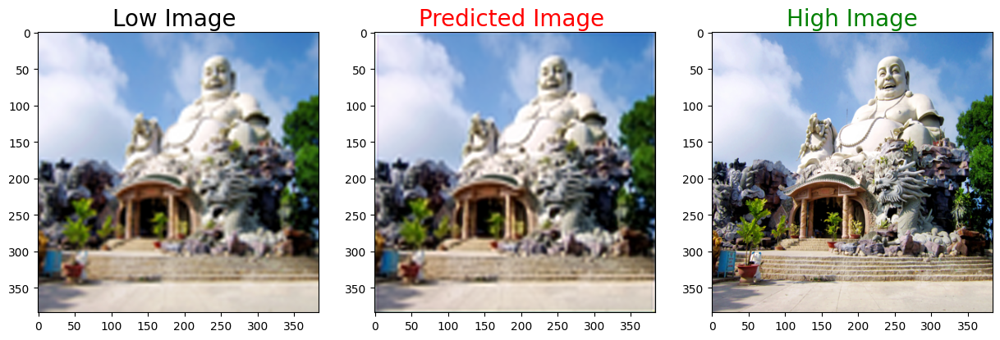

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


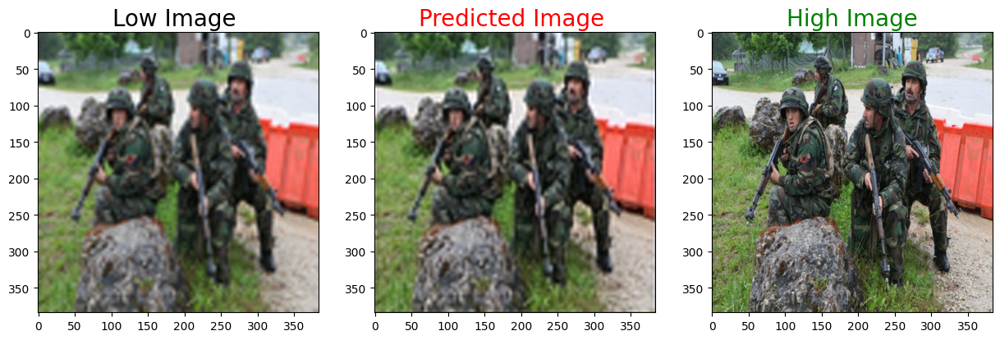

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


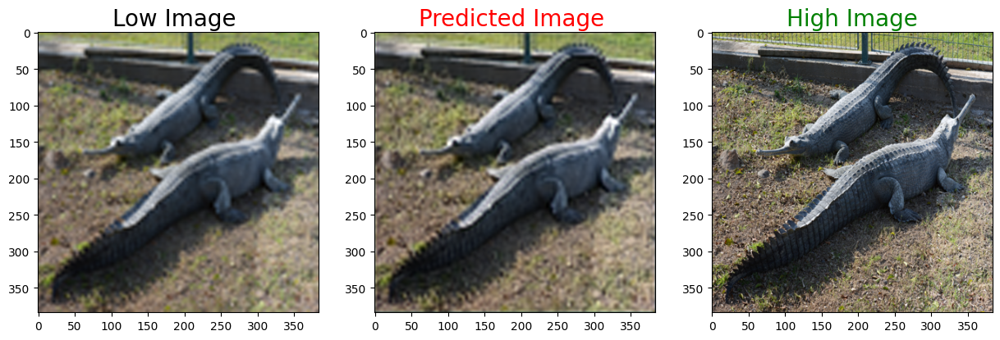

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


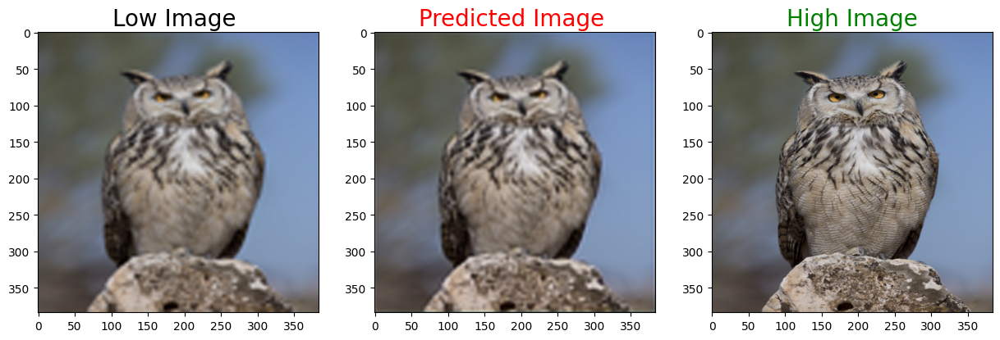

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


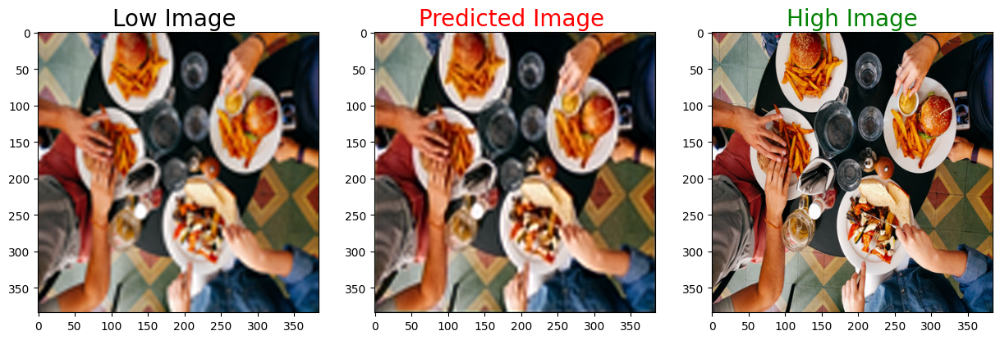

In [149]:
for i in range(10):
    plot_images(LR_val[i],prediction[i],HR_val[i])

# Upscailing method

In [2]:
#################
# Load Image
################
'''
SRCNN과 다른점은 저해상도 이미지를 초기에 upscaling하지 않는다는 점.
Conv layer 추가 및 중간에 Upsampling 수행
'''
HR_dir = './Data/HR/' # 고해상도 디렉토리 
LR_dir = './Data/LR' # 저해상도 디렉토리

def load_img(directory):
    img = []
    for img_dir in glob.glob(directory+str('/*')):
        tmp = plt.imread(img_dir)
#         tmp = cv2.resize(tmp,dsize=(384,384), interpolation=cv2.INTER_CUBIC)
        img.append(tmp)
    img = np.array(img)
    return img
HR_img = load_img(HR_dir)
LR_img = load_img(LR_dir)

print(f'HR Shape : {HR_img.shape}')
print(f'LR Shape : {LR_img.shape}')
#예시는 아래 참조

HR Shape : (100, 384, 384, 3)
LR Shape : (100, 96, 96, 3)


In [3]:
#################
# Train / Test
################
HR_train, HR_val, LR_train, LR_val = train_test_split(HR_img, LR_img, test_size=0.1)

#################
# Build Model
################
def build_model(input_shape=(96, 96, 3)):
    inputs = Input(input_shape, name='input')
    layer = Conv2D(32, 3, padding='same', activation='relu', name='conv1')(inputs)
    layer = Conv2D(64, 3, padding='same', activation='relu', name='conv2')(layer)
    layer = Conv2D(128, 9, padding='same', activation='relu', name='conv3')(layer)
    layer = Conv2D(64, 9, padding='same', activation='relu', name='conv4')(layer)
    layer = UpSampling2D(size = (2,2))(layer)
    layer = Conv2D(64, 3, padding='same', activation='relu', name='conv5')(layer)
    layer = Conv2D(128, 9, padding='same', activation='relu', name='conv6')(layer)
    layer = Conv2D(32, 3, padding='same', activation='relu', name='conv7')(layer)
    layer = Conv2D(32, 3, padding='same', activation='relu', name='conv8')(layer)
    layer = UpSampling2D(size = (2,2))(layer)
    output = Dense(3, activation='relu', name='output')(layer)
    return Model(inputs, output, name='Upscailing')
model = build_model()
def pixel_mse_loss(x,y):
    return tf.reduce_mean( (x - y) ** 2 )
def PSNR(y_true,y_pred):
    mse=tf.reduce_mean( (y_true - y_pred) ** 2 )
    return 20 * log10(1/ (mse ** 0.5))
model.compile(optimizer=optimizers.Adam(lr=0.001), loss='MSE') # 'mean_squared_error'
model.summary()

Model: "Upscailing"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(None, 96, 96, 3)]       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 96, 96, 32)        896       
_________________________________________________________________
conv2 (Conv2D)               (None, 96, 96, 64)        18496     
_________________________________________________________________
conv3 (Conv2D)               (None, 96, 96, 128)       663680    
_________________________________________________________________
conv4 (Conv2D)               (None, 96, 96, 64)        663616    
_________________________________________________________________
up_sampling2d (UpSampling2D) (None, 192, 192, 64)      0         
_________________________________________________________________
conv5 (Conv2D)               (None, 192, 192, 64)      3

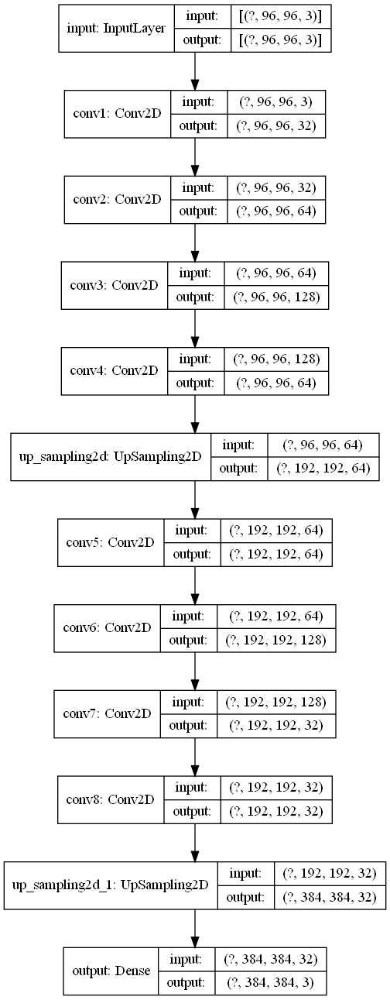

In [4]:
plot_model(model, to_file = 'Upscailing.png', show_shapes=True)

In [7]:
earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=20)

history = model.fit(LR_train, HR_train, batch_size=32, epochs=200,
                   callbacks=[earlystop_callback], validation_split = 0.2)

Epoch 1/200
3/3 [==============================] - 1s 364ms/step - loss: 0.1223 - val_loss: 0.0552
Epoch 2/200
3/3 [==============================] - 1s 354ms/step - loss: 0.0601 - val_loss: 0.0540
Epoch 3/200
3/3 [==============================] - 1s 356ms/step - loss: 0.0514 - val_loss: 0.0474
Epoch 4/200
3/3 [==============================] - 1s 356ms/step - loss: 0.0515 - val_loss: 0.0359
Epoch 5/200
3/3 [==============================] - 1s 338ms/step - loss: 0.0428 - val_loss: 0.0353
Epoch 6/200
3/3 [==============================] - 1s 334ms/step - loss: 0.0414 - val_loss: 0.0346
Epoch 7/200
3/3 [==============================] - 1s 336ms/step - loss: 0.0393 - val_loss: 0.0342
Epoch 8/200
3/3 [==============================] - 1s 340ms/step - loss: 0.0384 - val_loss: 0.0318
Epoch 9/200
3/3 [==============================] - 1s 372ms/step - loss: 0.0370 - val_loss: 0.0312
Epoch 10/200
3/3 [==============================] - 1s 356ms/step - loss: 0.0361 - val_loss: 0.0298
Epoch 11/

3/3 [==============================] - 1s 356ms/step - loss: 0.0097 - val_loss: 0.0107
Epoch 162/200
3/3 [==============================] - 1s 356ms/step - loss: 0.0097 - val_loss: 0.0100
Epoch 163/200
3/3 [==============================] - 1s 351ms/step - loss: 0.0092 - val_loss: 0.0094
Epoch 164/200
3/3 [==============================] - 1s 370ms/step - loss: 0.0088 - val_loss: 0.0098
Epoch 165/200
3/3 [==============================] - 1s 339ms/step - loss: 0.0088 - val_loss: 0.0093
Epoch 166/200
3/3 [==============================] - 1s 381ms/step - loss: 0.0087 - val_loss: 0.0094
Epoch 167/200
3/3 [==============================] - 1s 368ms/step - loss: 0.0086 - val_loss: 0.0094
Epoch 168/200
3/3 [==============================] - 1s 373ms/step - loss: 0.0085 - val_loss: 0.0091
Epoch 169/200
3/3 [==============================] - 1s 384ms/step - loss: 0.0083 - val_loss: 0.0089
Epoch 170/200
3/3 [==============================] - 1s 374ms/step - loss: 0.0082 - val_loss: 0.0089
Epoc

In [8]:
prediction = model.predict(LR_val)

In [9]:
def plot_images(low,pred,high):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Low Image ', color = 'black', fontsize = 20)
    plt.imshow(low)
    plt.subplot(1,3,2)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(pred)
    plt.subplot(1,3,3)
    plt.title('High Image', color = 'green', fontsize = 20)
    plt.imshow(high)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


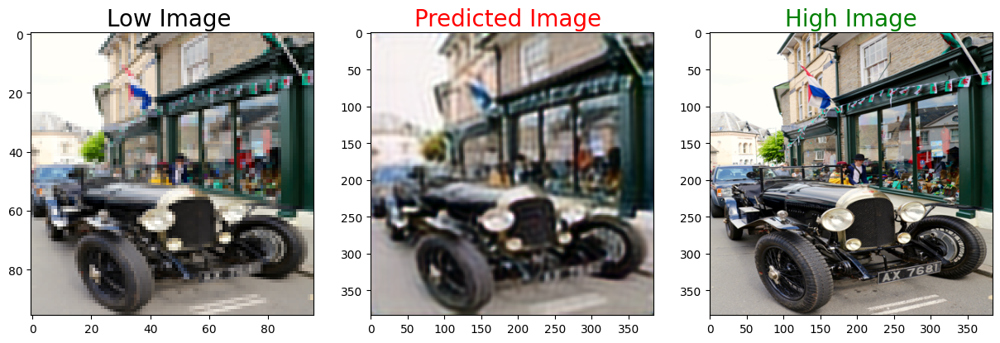

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


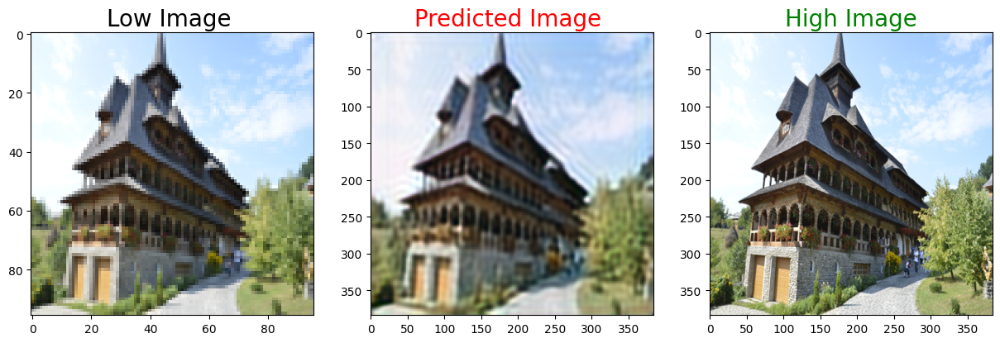

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


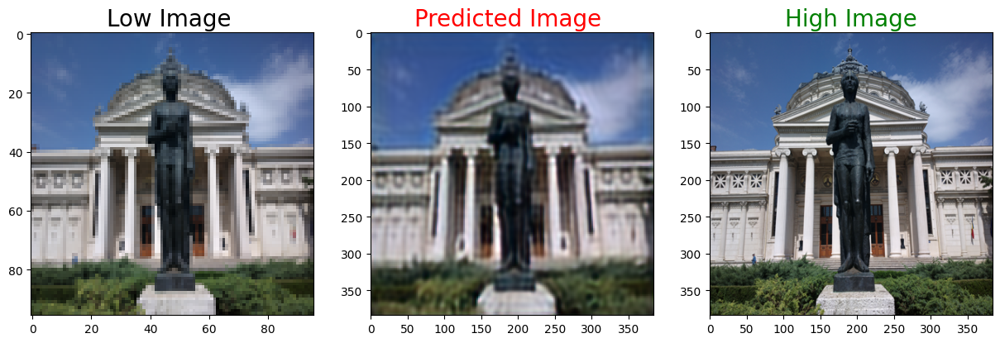

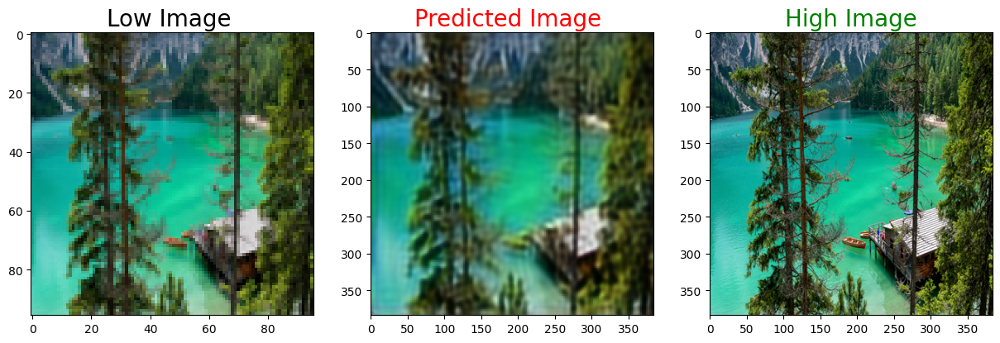

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


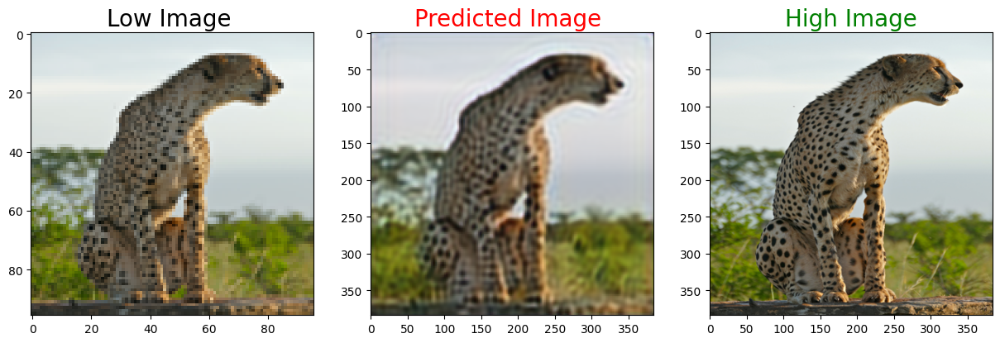

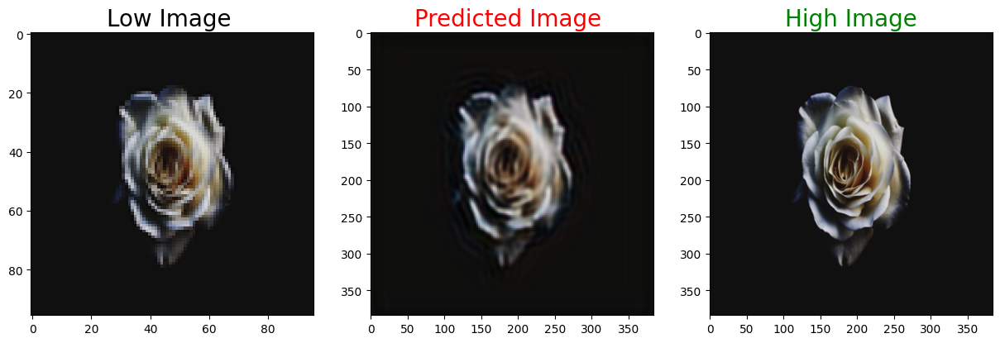

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


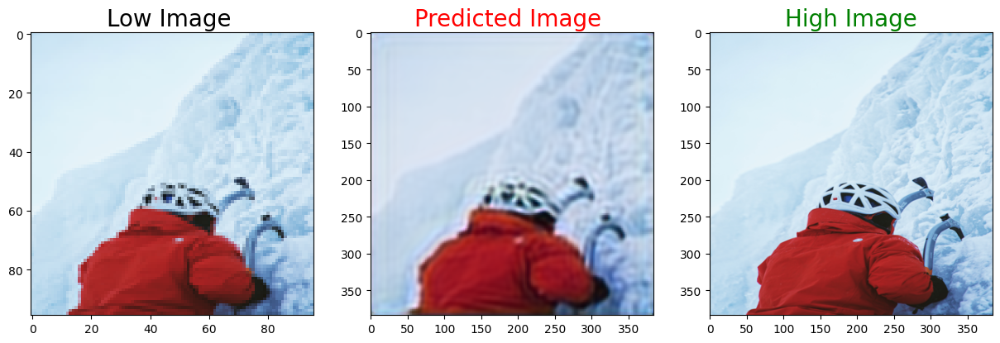

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


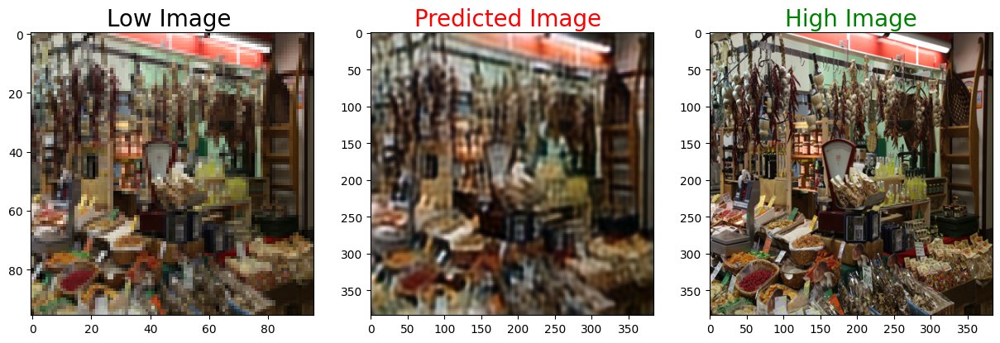

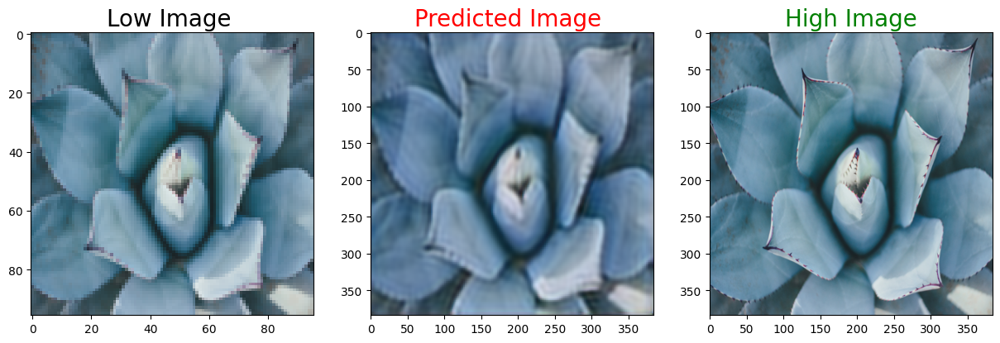

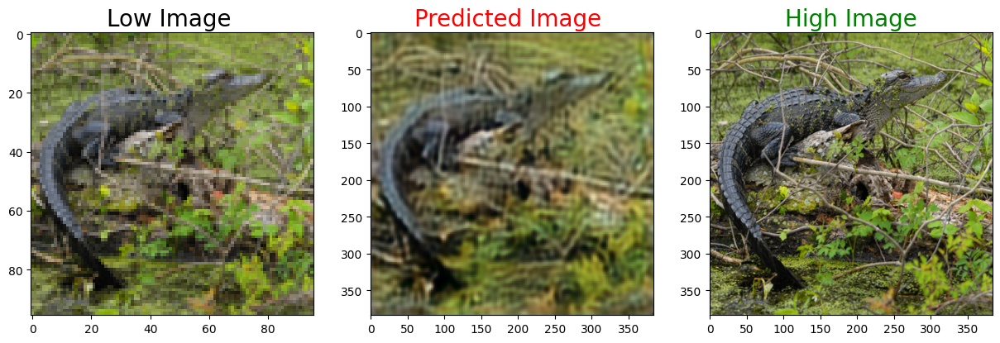

In [10]:
for i in range(10):
    plot_images(LR_val[i],prediction[i],HR_val[i])

# ESPCN (2016)

In [3]:
#################
# Load Image
################
'''
SRCNN과 다른점은 upscaling을 마지막 layer에 적용했다는 점.
기존과 upscailing 방식의 차이
참조 : https://mole-starseeker.tistory.com/m/84
'''
HR_dir = './Data/HR/' # 고해상도 디렉토리 
LR_dir = './Data/LR' # 저해상도 디렉토리

def load_img(directory):
    img = []
    for img_dir in glob.glob(directory+str('/*')):
        tmp = plt.imread(img_dir)
#         tmp = cv2.resize(tmp,dsize=(384,384), interpolation=cv2.INTER_CUBIC)
        img.append(tmp)
    img = np.array(img)
    return img
HR_img = load_img(HR_dir)
LR_img = load_img(LR_dir)

print(f'HR Shape : {HR_img.shape}')
print(f'LR Shape : {LR_img.shape}')
#예시는 아래 참조

HR Shape : (100, 384, 384, 3)
LR Shape : (100, 96, 96, 3)


In [5]:
#################
# Train / Test
################
HR_train, HR_val, LR_train, LR_val = train_test_split(HR_img, LR_img, test_size=0.1)

#################
# Build Model
################
upscale_factor = 4
def ESPCN(input_shape=(96, 96, 3)):
    inputs = Input(input_shape, name='input')
    layer = Conv2D(64, 5, padding='same', activation='relu', name='conv1')(inputs)
    layer = Conv2D(64, 3, padding='same', activation='relu', name='conv2')(layer)
    layer = Conv2D(32, 3, padding='same', activation='relu', name='conv3')(layer)
    layer = Conv2D(upscale_factor**2, 3, padding='same', activation='relu', name='conv4')(layer)
    output = Conv2D(3*(upscale_factor**2),3, padding='same', activation='relu', name='output')(layer)
    output = tf.nn.depth_to_space(output, upscale_factor)
#     output = Subpixel(3, 3, r=upscale_factor, padding='same', activation='relu')(layer)
    return Model(inputs, output, name='ESPCN')
model = ESPCN()
def pixel_mse_loss(x,y):
    return tf.reduce_mean( (x - y) ** 2 )
def PSNR(y_true,y_pred):
    mse=tf.reduce_mean( (y_true - y_pred) ** 2 )
    return 20 * log10(1/ (mse ** 0.5))
model.compile(optimizer=optimizers.Adam(lr=0.001), loss='MSE') # 'mean_squared_error'
model.summary()

Model: "ESPCN"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(None, 96, 96, 3)]       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 96, 96, 64)        4864      
_________________________________________________________________
conv2 (Conv2D)               (None, 96, 96, 64)        36928     
_________________________________________________________________
conv3 (Conv2D)               (None, 96, 96, 32)        18464     
_________________________________________________________________
conv4 (Conv2D)               (None, 96, 96, 16)        4624      
_________________________________________________________________
output (Conv2D)              (None, 96, 96, 48)        6960      
_________________________________________________________________
tf_op_layer_DepthToSpace (Te [(None, 384, 384, 3)]     0     

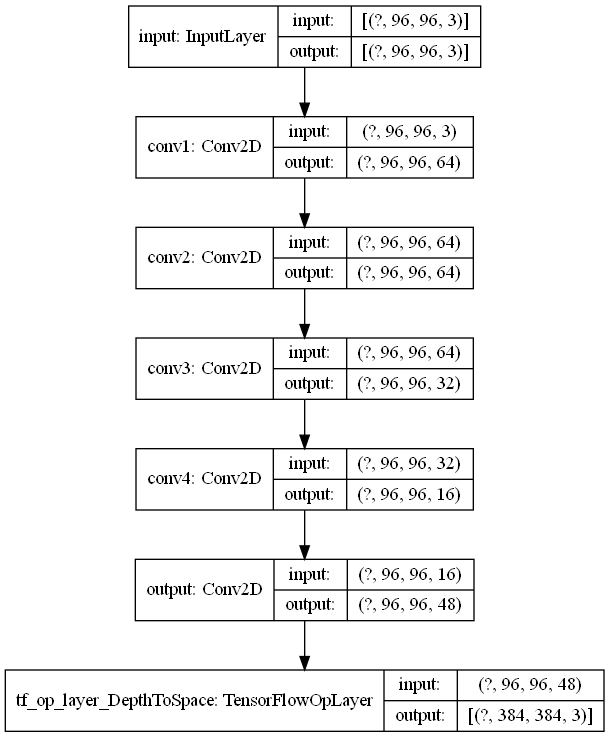

In [6]:
plot_model(model, to_file = 'ESPCN.png', show_shapes=True)

In [17]:
earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=20)

history = model.fit(LR_train, HR_train, epochs=500,batch_size=32,
                   callbacks=[earlystop_callback], validation_split = 0.2)

Epoch 1/500
3/3 [==============================] - 0s 83ms/step - loss: 0.1802 - val_loss: 0.1747
Epoch 2/500
3/3 [==============================] - 0s 42ms/step - loss: 0.1329 - val_loss: 0.1343
Epoch 3/500
3/3 [==============================] - 0s 41ms/step - loss: 0.1085 - val_loss: 0.1091
Epoch 4/500
3/3 [==============================] - 0s 40ms/step - loss: 0.0927 - val_loss: 0.0966
Epoch 5/500
3/3 [==============================] - 0s 41ms/step - loss: 0.0827 - val_loss: 0.0914
Epoch 6/500
3/3 [==============================] - 0s 41ms/step - loss: 0.0766 - val_loss: 0.0803
Epoch 7/500
3/3 [==============================] - 0s 41ms/step - loss: 0.0689 - val_loss: 0.0698
Epoch 8/500
3/3 [==============================] - 0s 37ms/step - loss: 0.0616 - val_loss: 0.0639
Epoch 9/500
3/3 [==============================] - 0s 37ms/step - loss: 0.0574 - val_loss: 0.0613
Epoch 10/500
3/3 [==============================] - 0s 44ms/step - loss: 0.0548 - val_loss: 0.0575
Epoch 11/500
3/3 [=

3/3 [==============================] - 0s 39ms/step - loss: 0.0062 - val_loss: 0.0046
Epoch 164/500
3/3 [==============================] - 0s 36ms/step - loss: 0.0061 - val_loss: 0.0046
Epoch 165/500
3/3 [==============================] - 0s 36ms/step - loss: 0.0061 - val_loss: 0.0046
Epoch 166/500
3/3 [==============================] - 0s 38ms/step - loss: 0.0061 - val_loss: 0.0045
Epoch 167/500
3/3 [==============================] - 0s 41ms/step - loss: 0.0061 - val_loss: 0.0045
Epoch 168/500
3/3 [==============================] - 0s 44ms/step - loss: 0.0061 - val_loss: 0.0045
Epoch 169/500
3/3 [==============================] - 0s 41ms/step - loss: 0.0061 - val_loss: 0.0046
Epoch 170/500
3/3 [==============================] - 0s 42ms/step - loss: 0.0061 - val_loss: 0.0047
Epoch 171/500
3/3 [==============================] - 0s 41ms/step - loss: 0.0063 - val_loss: 0.0049
Epoch 172/500
3/3 [==============================] - 0s 42ms/step - loss: 0.0063 - val_loss: 0.0046
Epoch 173/500


In [18]:
prediction = model.predict(LR_val)

In [19]:
def plot_images(low,pred,high):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Low Image ', color = 'black', fontsize = 20)
    plt.imshow(low)
    plt.subplot(1,3,2)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(pred)
    plt.subplot(1,3,3)
    plt.title('High Image', color = 'green', fontsize = 20)
    plt.imshow(high)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


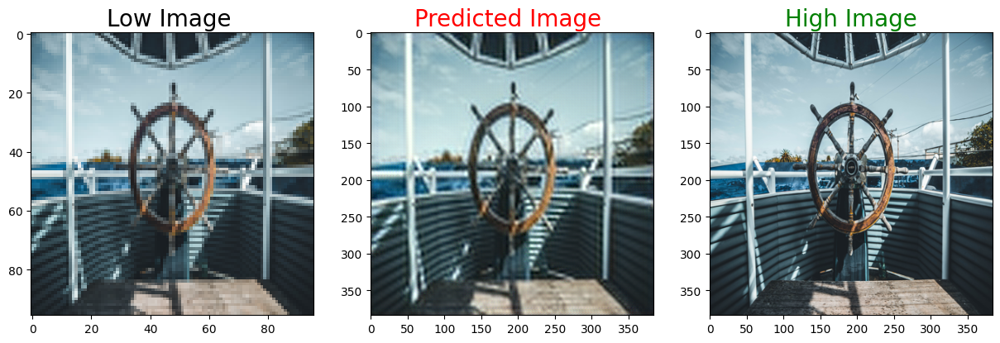

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


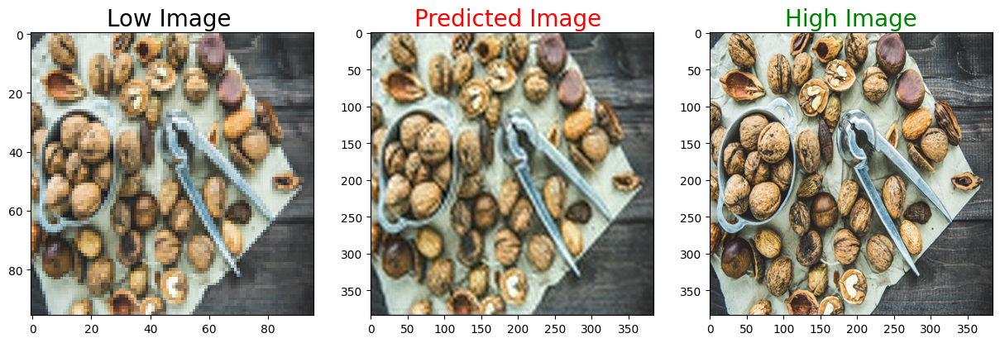

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


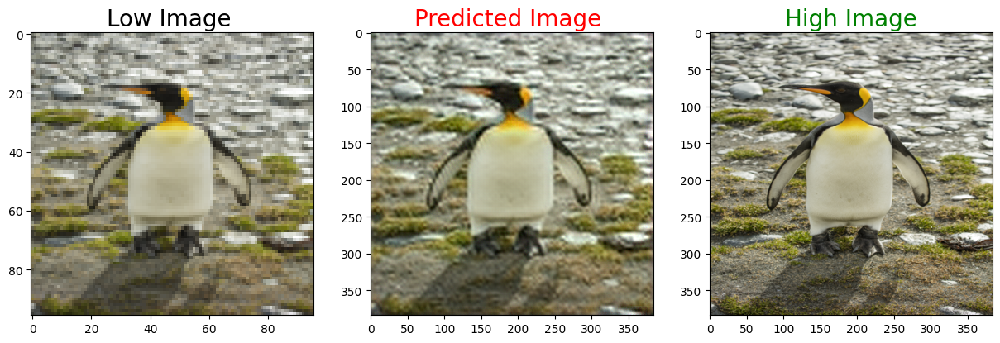

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


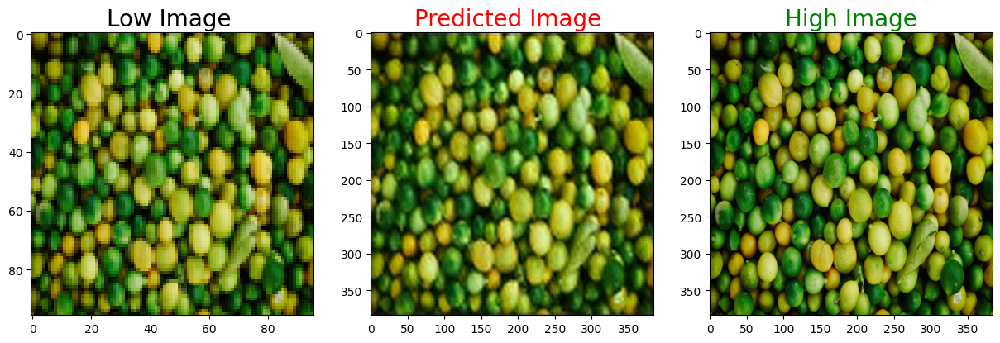

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


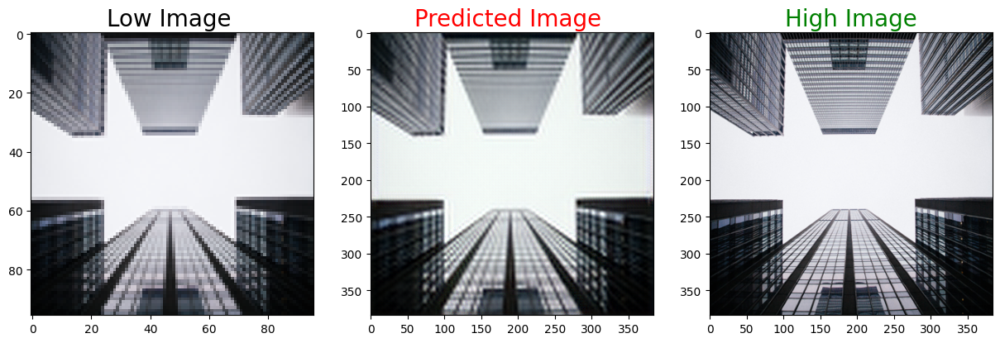

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


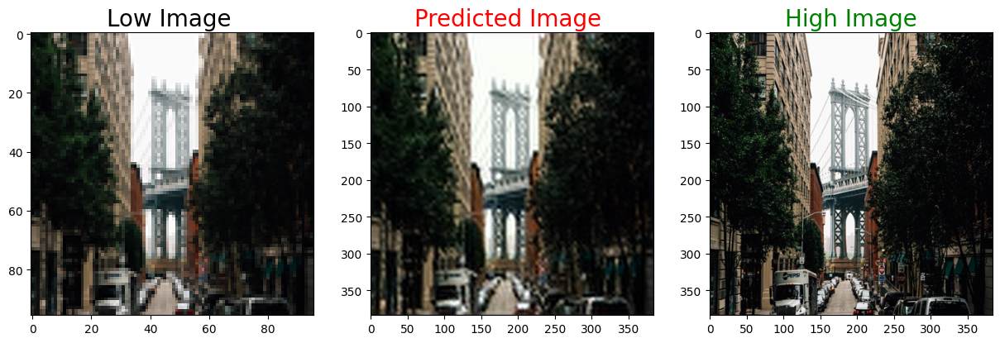

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


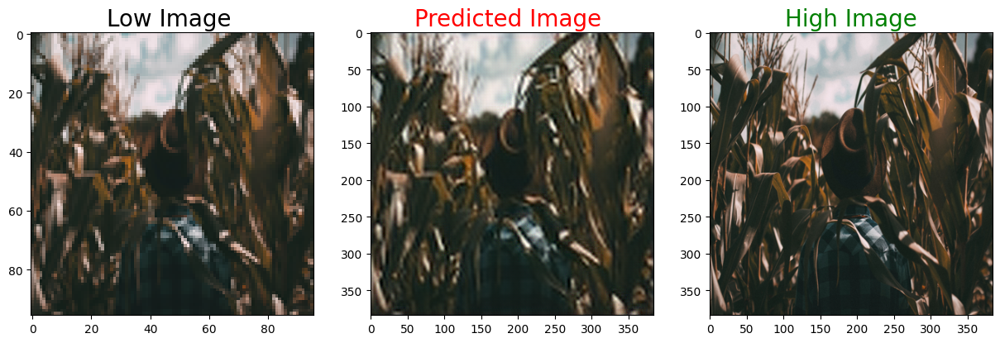

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


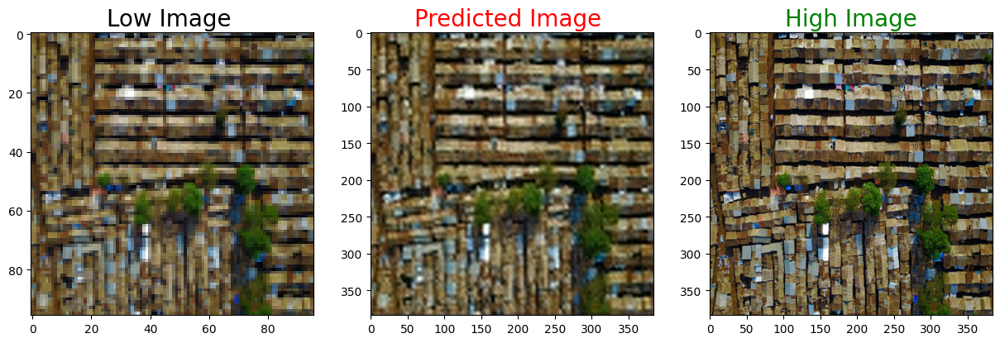

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


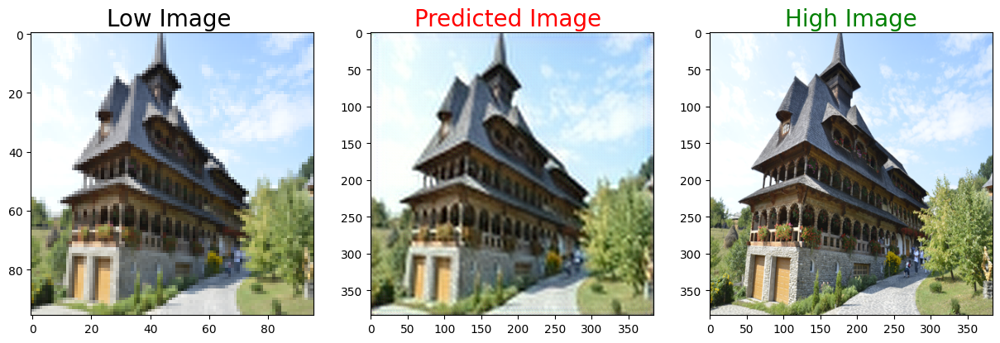

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


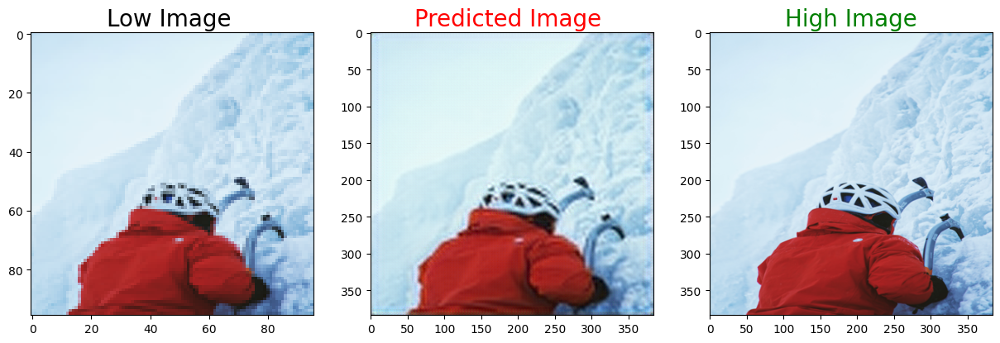

In [20]:
for i in range(10):
    plot_images(LR_val[i],prediction[i],HR_val[i])